# Long-short term Distributed Motion Planning

In [234]:
import sys
sys.path.append('../')
sys.path.append('../../')

import numpy as np
import cvxpy as cp
from matplotlib import pyplot as plt
from matplotlib.patches import Circle
from panav.env import NavigationEnv, Box2DRegion, PolygonRegion, box_2d_center, line_seg_to_obstacle
from panav.viz import draw_env


import shapely

from panav.ORCA import VO, ORCA_Agent
from panav.SAMP import SA_MILP_Planning
from panav.util import unique_tx

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Construct the environment

## Plan waypoints with MILP for individual agents, ignoring inter-agent conflicts. Use a simple controller to generate $v_{pref}$ that tracks the waypoints. Use ORCA to convert $v_{pref}$ to safe velocities.

**Construct the environment**

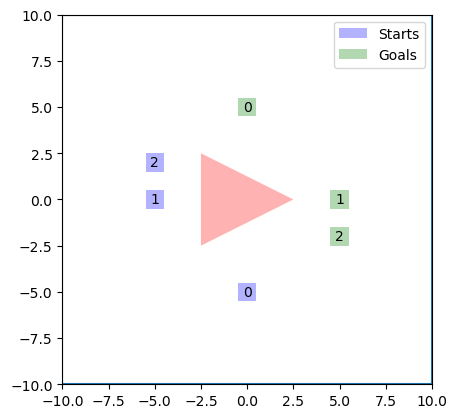

In [229]:

start_locs = np.array([[0,-5],[-5,0],[-5,2]])*1.0
goal_locs = np.array([[0,5],[5,0],[5,-2]])*1.0


start_box_side = np.array([1,1])
goal_box_side = np.array([1,1])

starts = [box_2d_center(s,start_box_side) for s in start_locs]

goals = [box_2d_center(g,goal_box_side) for g in goal_locs]

limits = [(-10.0,10.0),(-10.0,10.0)]

O1 = PolygonRegion([(-2.5,2.5),(-2.5,-2.5),(2.5,0)])

env = NavigationEnv(limits,[O1],starts,goals)

draw_env(env)

**Compute individual paths that avoid all static obstacles**

In [230]:
agents = set(np.arange(len(start_locs)))

plans = []

bloating_r = 0.5
d = 2
K = 10
t0 = 0
vmax = 1.0

for agent in agents:
    start = env.starts[agent]
    goal = env.goals[agent]

    times, xs = SA_MILP_Planning(env,start,goal,vmax,bloating_r,\
                                 [],\
                                d,K,t0)

    times,xs = unique_tx(times,xs)
    plans.append(xs)

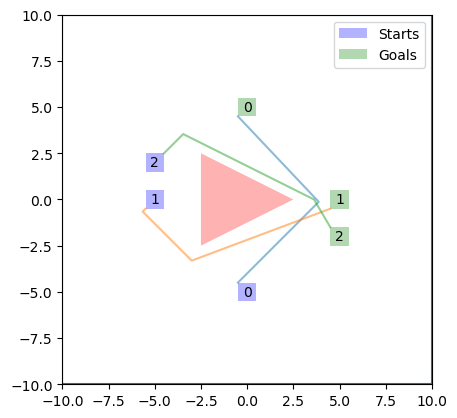

In [231]:

draw_env(env,plans)

In [232]:


safe_tau = 0.1 # The safe time interval. Can be generously long.
exec_tau = 1.0 * safe_tau 

detection_radius = bloating_r * 5
# The execution time of ORCA velocity.
# Can be shorter than the safe interval tau.

pos = []
vs = [np.zeros(start_locs[0].shape) for a in agents]
v_prefs = [np.zeros(start_locs[0].shape) for a in agents]

protocol = 0

orcas = [ORCA_Agent(protocol,safe_tau,bloating_r,vmax,p,v) 
         for p,v in zip(start_locs,vs)]

curr_wp_index = [0 for a in agents]

makespans = np.zeros(len(agents))

curr_time = 0
for _ in range(200):
    pos.append(np.array([a.p for a in orcas]))
    
    # Compute the preferred velocity.
    for agent in agents:
        wp = plans[agent][:,curr_wp_index[agent]]
        to_wp = wp-orcas[agent].p
        
        # See if the agent has reached the current waypoint.
        if np.linalg.norm(to_wp)<= bloating_r:  
            curr_wp_index[agent] = \
            np.min([curr_wp_index[agent]+1,   
                    plans[agent].shape[1]-1
                                  ])

        
        v_prefs[agent] = vmax * to_wp / np.linalg.norm(to_wp)
    
    # Update v_opt
    for a in agents:
        orcas[a].update_v_opt(v_prefs[a])
    
    # Compute the safe velocity.
    for a in agents:      
        nb = [orcas[b] for b in agents-set([a])
              if np.linalg.norm(orcas[a].p-orcas[b].p)<= detection_radius]
        orcas[a].update_v(v_prefs[a],env.obstacles,
                        nb)
        # print(a,orcas[a].v-v_prefs[a])
    
    # Execute the safe velocity.
    all_reached = True
    curr_time +=exec_tau
    for a in agents:
        if np.linalg.norm(orcas[a].p \
                        - goals[a].project(orcas[a].p))\
                        >=0.1*bloating_r:
            orcas[a].p += orcas[a].v*exec_tau
            all_reached = False
            makespans[a] = curr_time
    
    
    if all_reached:
        break

In [233]:
makespans

array([12.9, 12.4, 15.1])

**Visualize the trajectories**

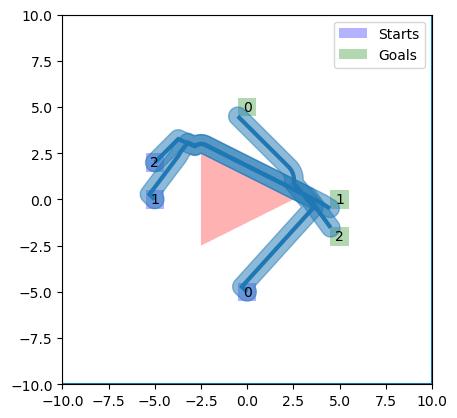

In [219]:

from shapely.plotting import plot_polygon, plot_line
pos = np.array(pos)

ax = plt.gca()
draw_env(env,[],ax)

for a in agents:
    line = shapely.geometry.LineString(pos[:,a,:])
    dilated = line.buffer(bloating_r)

    plot_line(line, ax=ax, add_points=False, linewidth=3)
    plot_polygon(dilated, ax=ax, add_points=False, alpha=0.5)

**Animate the motions**

In [179]:
from panav.viz import animation
from IPython.display import HTML, display

dt = 0.025

pos_to_ani = [pos[:,a,:].T for a in agents]
anim = animation(env, pos_to_ani, bloating_r, dt = dt)
plt.title('Flowtime:{:.2f}'.format(np.sum(makespans)))
display(HTML(anim.to_jshtml()))
anim.save('Individual_RCA.gif')
plt.close() 

MovieWriter ffmpeg unavailable; using Pillow instead.


**Observation**: Letting $v_{pref}$ follow the individually planned paths is sufficient for the agents to reach their goals while staying safe.

## Run the same experiment on LSDMP

In [104]:
from panav.LSDMP import LSDMP


start_locs = np.array([[0,-5],[-5,0],[-5,2]])*1.0
goal_locs = np.array([[0,5],[5,0],[5,-2]])*1.0


start_box_side = np.array([1,1])
goal_box_side = np.array([1,1])

starts = [box_2d_center(s,start_box_side) for s in start_locs]

goals = [box_2d_center(g,goal_box_side) for g in goal_locs]

limits = [(-10.0,10.0),(-10.0,10.0)]

O1 = PolygonRegion([(-2.5,2.5),(-2.5,-2.5),(2.5,0)])

env = NavigationEnv(limits,[O1],starts,goals)


agents = set(np.arange(len(start_locs)))

bloating_r = 0.5
d = 2
K = 10
t0 = 0
vmax = 1.0

safe_tau = 0.5 # The safe time interval. Can be generously long.
exec_tau = 1.0 * safe_tau 

pos = [[] for a in agents]
p = np.array(start_locs)
v = np.zeros(p.shape)

detection_radius = bloating_r * 5

makespans = np.zeros(len(agents))

curr_time = 0

for _ in range(200):
    # Compute the safe velocity.
    for a in agents:
        neighbor_locs = []
        for b in agents-{a}:
            if np.linalg.norm(p[a]-p[b])<= detection_radius:
                neighbor_locs.append(p[b])
        times,xs = unique_tx(*LSDMP(env,p[a],env.goals[a],
                                   neighbor_locs,safe_tau,
                                   vmax,bloating_r, d,K,t0))
        v[a] = (xs[:,1]-xs[:,0])/(times[1]-times[0])
        
    # Execute the safe velocity.
    all_reached = True
    curr_time+= exec_tau
    for a in agents:
        pos[a].append(np.array(p[a]))
        if np.linalg.norm(p[a] \
                        - goals[a].project(p[a]))\
                        >=0.1*bloating_r:
            p[a] += v[a]*exec_tau
            all_reached = False
            makespans[a] = curr_time
    
    if all_reached:
        break

In [105]:
makespans

array([14., 17., 15.])

In [106]:

pos = np.array(pos)
pos = np.array([p.T for p in pos])

In [107]:
from panav.viz import animation
from IPython.display import HTML, display

dt = 0.025

pos_to_ani = np.array(pos)
anim = animation(env, pos_to_ani, bloating_r, dt = dt)
plt.title('Flowtime:{:.2f}'.format(np.sum(makespans)))
display(HTML(anim.to_jshtml()))
anim.save('LSDMP.gif')
plt.close() 

MovieWriter ffmpeg unavailable; using Pillow instead.


## Deadlock caused by the ignorance of inter-agent conflict

On more challenging environments, planning waypoints for individual agents while ignoring inter-agent conflicts could be insufficient. For example, such paradigm could result in deadlock, as show below. 

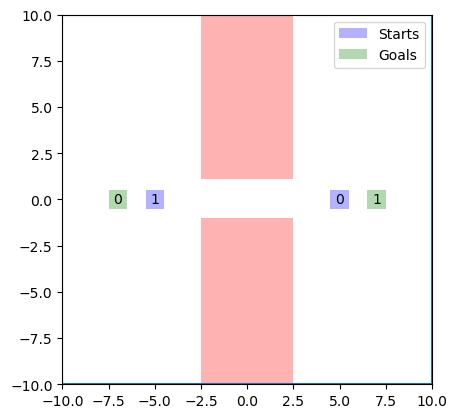

In [248]:

start_locs = np.array([[5,0],[-5,0]])*1.0
goal_locs = np.array([[-7,0],[7,0]])*1.0


start_box_side = np.array([1,1])
goal_box_side = np.array([1,1])

starts = [box_2d_center(s,start_box_side) for s in start_locs]

goals = [box_2d_center(g,goal_box_side) for g in goal_locs]

O1 = Box2DRegion((-2.5,2.5),(1.1,10))
O2 = Box2DRegion((-2.5,2.5),(-10,-1.0))

limits = [(-10.0,10.0),(-10.0,10.0)]

bloating_r = 0.5 

env = NavigationEnv(limits,[O1,O2],starts,goals)

draw_env(env)

**Compute individual paths that avoid all static obstacles**

In [249]:
agents = set(np.arange(len(start_locs)))

plans = []

bloating_r = 0.5
d = 2
K = 10
t0 = 0
vmax = 1.0

for agent in agents:
    start = env.starts[agent]
    goal = env.goals[agent]

    times, xs = SA_MILP_Planning(env,start,goal,vmax,bloating_r,\
                                 [],\
                                d,K,t0)

    times,xs = unique_tx(times,xs)
    plans.append(xs)

In [250]:


tau = 0.1 # The safe time interval. Can be generously long.
exec_tau = 1.0 * tau 
# The execution time of ORCA velocity.
# Can be shorter than the safe interval tau.

pos = []
vs = [np.zeros(start_locs[0].shape) for a in agents]
v_prefs = [np.zeros(start_locs[0].shape) for a in agents]

protocol = 2

orcas = [ORCA_Agent(protocol,tau,bloating_r,vmax,p,v) 
         for p,v in zip(start_locs,vs)]

curr_wp_index = [0 for a in agents]

makespans = np.zeros(len(agents))

curr_time = 0
for _ in range(200):
    pos.append(np.array([a.p for a in orcas]))
    
    # Compute the preferred velocity.
    for agent in agents:
        wp = plans[agent][:,curr_wp_index[agent]]
        to_wp = wp-orcas[agent].p
        
        # See if the agent has reached the current waypoint.
        if np.linalg.norm(to_wp)<= bloating_r:  
            curr_wp_index[agent] = \
            np.min([curr_wp_index[agent]+1,   
                    plans[agent].shape[1]-1
                                  ])

        
        v_prefs[agent] = vmax * to_wp / np.linalg.norm(to_wp)
    
    # Update v_opt
    for a in agents:
        orcas[a].update_v_opt(v_prefs[a])
    
    # Compute the safe velocity.
    for a in agents:      
        orcas[a].update_v(v_prefs[a],env.obstacles,
                        [orcas[b] for b in agents-set([a])])
    
    # Execute the safe velocity.
    all_reached = True
    curr_time +=exec_tau
    for a in agents:
        if np.linalg.norm(orcas[a].p \
                        - goals[a].project(orcas[a].p))\
                        >=1*bloating_r:
            orcas[a].p += orcas[a].v*exec_tau
            all_reached = False
            makespans[a] = curr_time
    
    
    if all_reached:
        break

**Visualize the trajectories**

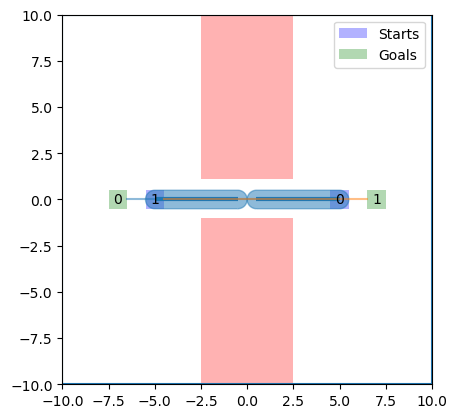

In [251]:

from shapely.plotting import plot_polygon, plot_line
pos = np.array(pos)

ax = plt.gca()
draw_env(env,plans,ax)

for a in agents:
    line = shapely.geometry.LineString(pos[:,a,:])
    dilated = line.buffer(bloating_r)

    plot_line(line, ax=ax, add_points=False, linewidth=3)
    plot_polygon(dilated, ax=ax, add_points=False, alpha=0.5)

**Animate the motions**

In [119]:
from panav.viz import animation
from IPython.display import HTML, display

dt = 0.025

pos_to_ani = [pos[:,a,:].T for a in agents]
anim = animation(env, pos_to_ani, bloating_r, dt = dt)
display(HTML(anim.to_jshtml()))
anim.save('Individual_RCA_deadlock.gif')
plt.close() 

MovieWriter ffmpeg unavailable; using Pillow instead.


The deadlock is because the individual planning does not address conflicts among different agents, but not a fault of ORCA. If the planning takes into account the conflict between agents, deadlock won't arise. 

Centralized MAMP algorithms like S2M2 can be used to compute a conflict-free multi-agent plan. But centralized algorithm typically does not scale well when the number of agents is large.

A combination of ORCA and individual planning can be used to resolve inter-agent conflicts in a distributed fashion, avoiding deadlick while keeping the computation efficient.

# Long-short term distributed motion planning

$\mathcal{X}:$ motion planning space.

$x_{i}^0,t_{i}^0$: starting time and location for agent $i$, assumed given. 

$\mathcal{O}_1,\mathcal{O}_2,...,\mathcal{O}_N$: static, polytopic obstacles.

$\mathcal{X}_i^{goal}$: goal region for agent $i$.

$v_{\max}:$ maximal speed of the agent.

$\tau:$ the safe horizon for $ORCA$, within which the agent does not collide with others.

$ORCA_i(\tau,x_i,\{x_j\text{ for all neighboring agents }j\}):$ the set of safe velocities of agent $i$, given its current location $x_i$ and neighoring agents' current locations $x_j$. It is represented by a set of linear constraints dependent on $\tau$, $x_i$, and $x_j$'s. 


The optimization problem to be solved by agent $i$:
$$
	\begin{aligned}
		&\min_{t_i^{1:K},x_i^{1:K}} t_i^K\\
		\text{subject to }&\\
		&x_i^{1:K}\in \mathcal{X}, x_i^K\in \mathcal{X}_i^{goal}\\
		&||x_i^{k+1}-x_i^{k}||\leq v_{\max}(t_i^{k+1}-t_i^k),~\forall k \in 1,2,...,K-1\\
		&\uparrow\text{(approximate with $\infty$ norm to preserve linearity)}\\
		& x_i^{1:K} \notin \mathcal{O}_{j}, \forall k\in 1:K, j\in 1:N\\
		&\uparrow\text{(modeled using big-$M$ method)}\\
		& (x_i^1-x_i^0)/\tau \in ORCA_i(\tau, x_i^0,\{x_j\text{ for all neighboring agents }j\})\\
		& t_i^1-t_i^0= \tau \\
		& t_i^{k+1}-t_i^k\geq 0,\forall k=0,1,2...,K-1
	\end{aligned}
$$

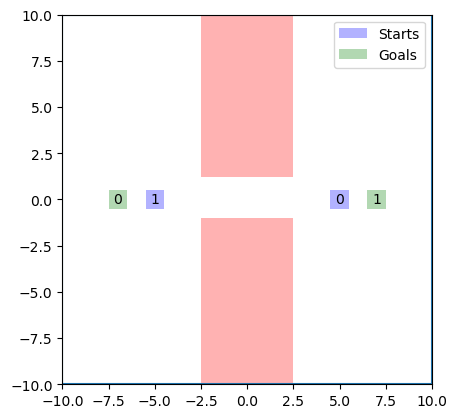

In [120]:

start_locs = np.array([[5,0],[-5,0]])*1.0
goal_locs = np.array([[-7,0],[7,0]])*1.0


start_box_side = np.array([1,1])
goal_box_side = np.array([1,1])

starts = [box_2d_center(s,start_box_side) for s in start_locs]

goals = [box_2d_center(g,goal_box_side) for g in goal_locs]

O1 = Box2DRegion((-2.5,2.5),(1.2,10))
O2 = Box2DRegion((-2.5,2.5),(-10,-1.0))

limits = [(-10.0,10.0),(-10.0,10.0)]

bloating_r = 0.5 

env = NavigationEnv(limits,[O1,O2],starts,goals)

draw_env(env)

In [13]:
from panav.LSDMP import LSDMP

In [122]:
agents = set(np.arange(len(start_locs)))

bloating_r = 0.5
d = 2
K = 10
t0 = 0
vmax = 1.0

safe_tau = 0.5
exec_tau = 1.0 * safe_tau

pos = [[] for a in agents]
p = np.array(start_locs)
v = np.zeros(p.shape)

detection_radius = bloating_r * 5


for _ in range(200):
    # Compute the safe velocity.
    for a in agents:
        neighbor_locs = []
        for b in agents-{a}:
            if np.linalg.norm(p[a]-p[b])<= detection_radius:
                neighbor_locs.append(p[b])
        times,xs = unique_tx(*LSDMP(env,p[a],env.goals[a],
                                   neighbor_locs,safe_tau,
                                   vmax,bloating_r, d,K,t0))
        v[a] = (xs[:,1]-xs[:,0])/(times[1]-times[0])
        
    # Execute the safe velocity.
    all_reached = True
    for a in agents:
        pos[a].append(np.array(p[a]))
        if np.linalg.norm(p[a] \
                        - goals[a].project(p[a]))\
                        >=1*bloating_r:
            p[a] += v[a]*exec_tau
            all_reached = False
    if all_reached:
        break

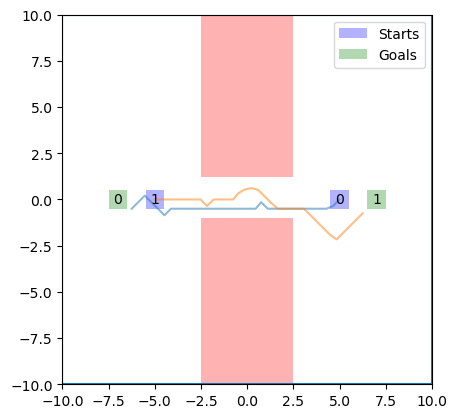

In [124]:

from shapely.plotting import plot_polygon, plot_line

pos = np.array(pos)
pos = np.array([p.T for p in pos])

ax = plt.gca()
draw_env(env,pos,ax)

In [126]:
from panav.viz import animation
from IPython.display import HTML, display

dt = 0.025

pos_to_ani = pos
anim = animation(env, pos_to_ani, bloating_r, dt = dt)
display(HTML(anim.to_jshtml()))
anim.save('LSDMP_No_deadlock.gif')
plt.close() 
plt.close() 

MovieWriter ffmpeg unavailable; using Pillow instead.


# Limitation of LSDMP
Although LSDMP shows a distributed way to avoid deadlock, it cannot handle some more difficult environment conditions. For instance, when the tunnel diameter is so small that it only allows one agent to pass at a time. Centralized MAMP algorithms(like PBS) must be adopted in such cases.

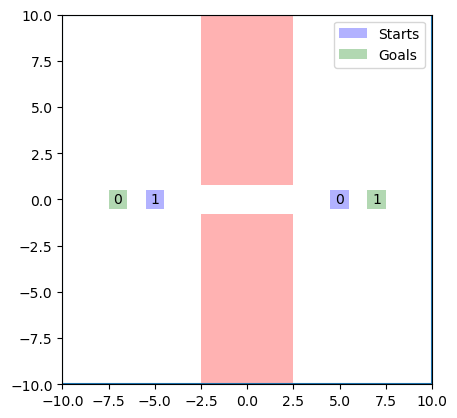

In [127]:

start_locs = np.array([[5,0],[-5,0]])*1.0
goal_locs = np.array([[-7,0],[7,0]])*1.0


start_box_side = np.array([1,1])
goal_box_side = np.array([1,1])

starts = [box_2d_center(s,start_box_side) for s in start_locs]

goals = [box_2d_center(g,goal_box_side) for g in goal_locs]

O1 = Box2DRegion((-2.5,2.5),(0.8,10))
O2 = Box2DRegion((-2.5,2.5),(-10,-0.8))

limits = [(-10.0,10.0),(-10.0,10.0)]

bloating_r = 0.5 

env = NavigationEnv(limits,[O1,O2],starts,goals)

draw_env(env)

# Planning using LSDMP

In [128]:
agents = set(np.arange(len(start_locs)))

bloating_r = 0.5
d = 2
K = 10
t0 = 0
vmax = 1.0

safe_tau = 1.0
exec_tau = 0.3 * safe_tau

pos = [[] for a in agents]
p = np.array(start_locs)
v = np.zeros(p.shape)

detection_radius = bloating_r * 5


for _ in range(200):
    # Compute the safe velocity.
    for a in agents:
        neighbor_locs = []
        for b in agents-{a}:
            if np.linalg.norm(p[a]-p[b])<= detection_radius:
                neighbor_locs.append(p[b])
        times,xs = unique_tx(*LSDMP(env,p[a],env.goals[a],
                                   neighbor_locs,safe_tau,
                                   vmax,bloating_r, d,K,t0))
        v[a] = (xs[:,1]-xs[:,0])/(times[1]-times[0])
        
    # Execute the safe velocity.
    all_reached = True
    for a in agents:
        pos[a].append(np.array(p[a]))
        if np.linalg.norm(p[a] \
                        - goals[a].project(p[a]))\
                        >=1*bloating_r:
            p[a] += v[a]*exec_tau
            all_reached = False
    if all_reached:
        break

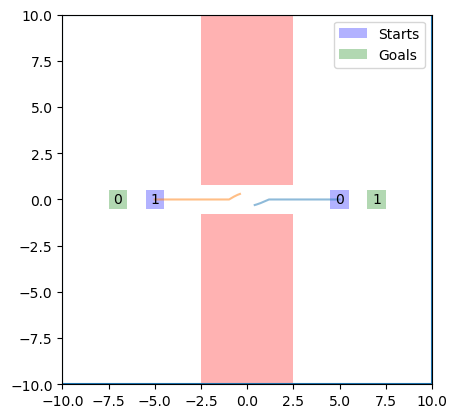

In [129]:

from shapely.plotting import plot_polygon, plot_line

pos = np.array(pos)
pos = np.array([p.T for p in pos])

ax = plt.gca()
draw_env(env,pos,ax)

In [130]:
from panav.viz import animation
from IPython.display import HTML, display

dt = 0.05

pos_to_ani = pos
anim = animation(env, pos_to_ani, bloating_r, dt = dt)
display(HTML(anim.to_jshtml()))
anim.save('LSDMP_oneway.gif')
plt.close() 

MovieWriter ffmpeg unavailable; using Pillow instead.


# Planning with PBS

In [131]:
from panav.PBS.PBS import PBS
from panav.util import interpolate_positions

In [ ]:
metric = 'flowtime'
search_type = 'depth_first'

max_iter = 20

solution,cost = PBS(env,vmax,bloating_r,d,K,t0,\
                    max_iter,metric,search_type)

Skipping ij (0, 1) prev_ordering [(1, 0)]


In [133]:
interp_dt = 0.1
pos = []

for t,x in solution:
    t,x = interpolate_positions(t,x,interp_dt)
    pos.append(x)

anim = animation(env, pos, bloating_r, dt = interp_dt / 4)
display(HTML(anim.to_jshtml()))
anim.save('PBS_oneway.gif')
plt.close()   # Avoid plotting an extra figure.

MovieWriter ffmpeg unavailable; using Pillow instead.
